In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scipy
import scipy.stats as stats
import pickle
import obspy
from scipy.signal import find_peaks
import os
import pandas as pd

import cmcrameri.cm as cmc

from matplotlib import patches
import seaborn as sns


In [2]:
time = 2

In [3]:
def get_scardec_stf(scardec_name, wanted_type = 'fctopt'):
    time = []
    momentrate = []

    event = os.listdir(f'/home/earthquakes1/homes/Rebecca/phd/stf/data/scardec/{scardec_name}')
    starts = [n for n, l in enumerate(event) if l.startswith(wanted_type)]
    with open(f'/home/earthquakes1/homes/Rebecca/phd/stf/data/scardec/{scardec_name}/{event[starts[0]]}') as f:
        lines = f.read().splitlines()

    lines = lines[2:]
    for line in lines:
        split = line.split(' ')
        split = [s for s in split if s not in ['', ' ', '\n']]
        time.append(float(split[0]))
        momentrate.append(float(split[1]))

    momentrate = np.array(momentrate)
    time = np.array(time)
    return momentrate, time

In [4]:
def get_ye_stf(ye_name):
    data_path = '/home/earthquakes1/homes/Rebecca/phd/stf/data/Ye_et_al_2016/'
    momentrate = []
    time = []

    with open(data_path + str(ye_name), 'r') as f:
        data = f.readlines()
        for line in data:
            line = line.strip()
            line = line.rstrip()
            if line[0] not in ['0','1','2','3','4','5','6','7','8','9']:
                continue
            line = line.split()
            time.append(float(line[0]))
            momentrate.append(float(line[1]))
    momentrate = np.array(momentrate)
    time = np.array(time)
    return momentrate, time

In [5]:
def get_usgs_stf(usgs_name):
    data_path = '/home/earthquakes1/homes/Rebecca/phd/stf/data/USGS/'
    momentrate = []
    time = []

    with open(data_path + str(usgs_name), 'r') as f:
        data = f.readlines()
        for line in data:
            line = line.strip()
            line = line.rstrip()
            if line[0] not in ['0','1','2','3','4','5','6','7','8','9']:
                continue
            line = line.split()
            time.append(float(line[0]))
            momentrate.append(float(line[1]))

    momentrate = np.array(momentrate)
    time = np.array(time)

    if usgs_name == '19950205_225105.txt' or usgs_name == '20041226_005853.txt':
        momentrate = momentrate
    elif int(usgs_name[0:4]) < 2021:
        momentrate = momentrate / 10**7 # convert to Nm from dyne cm
    elif int(usgs_name[0:4]) == 2021:
        if int(usgs_name[4:6]) < 5:
            momentrate = momentrate / 10**7
    else:
        momentrate = momentrate
    return momentrate, time

In [6]:
def get_sigloch_stf(sigloch_name):
    data_path = '/home/siglochnas1/shared/AmplitudeProjects/pdata_processed/psdata_events/'
    momentrate = []
    time = []

    file_path = data_path + str(sigloch_name) + '/outfiles/ampinv.stf.xy'

    with open(file_path, 'r') as file:
        content = file.read()
        content = content.split('\n')
        greater_than_count = content.count('>')
        if greater_than_count > 0:
            time = [list(np.arange(0, 25.6, 0.1))]
            momentrate = [[]]
            for i in range(greater_than_count-1):
                time.append(list(np.arange(0, 25.6, 0.1)))
                momentrate.append([])


        stf_count = 0
        for c in content:
            if c not in ['<', '>', '']:
                split = c.split()
                #time[stf_count].append(float(split[0]))
                momentrate[stf_count].append(10**float(split[1]))
            else:
                stf_count += 1

    # time = np.arange(0, 25.6, 0.1)
    # time = np.array(time)
    return momentrate, time

In [7]:
def get_isc_stf(isc_name):
    isc_save_path = '/home/earthquakes1/homes/Rebecca/phd/stf/data/isc/'
    with open(f'{isc_save_path}{isc_name}/{isc_name}.txt', 'rb') as f:
        stf_list = pickle.load(f)
    with open(f'{isc_save_path}{isc_name}/{isc_name}_norm_info.txt', 'rb') as f:
        norm_dict = pickle.load(f)

    time = np.arange(0, 25.6, 0.1)
    momentrate = np.array(stf_list)*norm_dict['mo_norm']*10**8,
    #print(momentrate)
    return momentrate[0], time

In [8]:
combined = pd.read_csv('/home/earthquakes1/homes/Rebecca/phd/stf/data/combined_scardec_ye_usgs_sigloch_isc_mag.csv')

In [9]:
combined.columns = ['event', 'scardec', 'ye', 'isc', 'sigloch', 'usgs', 'mag']

In [10]:
def myround(x, base=1):
    return base * round(x/base)

In [11]:
def find_end_stf(momentrate, time, dataset = ''):
    not_zero = np.where(momentrate > 0)[0]
    #print(max(momentrate))
    start = min(not_zero)
    end = max(not_zero)

    detected_end = end
    detected_end_time = time[end]

    time = time[:end]
    momentrate = momentrate[:end]

    less_than_10 = np.where(momentrate <= 10*max(momentrate)/100)[0]

    if dataset == 'sigloch':
        start = np.where(momentrate > 0.05 * max(momentrate))[0][0]
    else:
        start = min(not_zero)
    #print(less_than_10)
    total_moment = scipy.integrate.simpson(momentrate[start:end],
                                        dx = time[1]-time[0])
    #print(less_than_10)
    for i in less_than_10:
        if i <= start:
            continue
        if i == 0:
            continue
        moment = scipy.integrate.simpson(momentrate[start:i],
                                        dx = time[1]-time[0])
        #print(i, moment/total_moment)
        if moment >= 0.5 * total_moment:
            #print('inif')
            #print(f'first time where < 10% of total momentrate and 50% of moment released: {time[i]} s')
            detected_end_time = time[i]
            detected_end = i
            #print(f'proportion of moment released: {(moment/total_moment)*100:.2f}%')
            break
    return detected_end_time, detected_end, time[start], start
    #return time[end], end

In [12]:
# looks for time value of root
def f3(end_time, total_moment, time_opt, momentrate_opt, start, points_before_zero, proportion = 0.1):
    dx = time_opt[1]-time_opt[0]
    end_window = (end_time/dx)+points_before_zero
    end = int(np.floor(end_window))
    if start == end:
        end += 1
    short = scipy.integrate.simpson(momentrate_opt[start:end], dx = dx)
    return short-(total_moment*proportion)

In [13]:
def moment_in_different_windows(window = None, window_prop = None, combined=None):
#def moment_in_different_windows(window = None, window_prop = None, combined=None):
    #window = 1
    #window_prop = None
    if combined is None:
        combined = pd.read_csv('/home/earthquakes1/homes/Rebecca/phd/stf/data/combined_scardec_ye_usgs_sigloch_isc_mag.csv')
        combined.columns = ['event', 'scardec', 'ye', 'isc', 'sigloch', 'usgs', 'mag']
    if window is None and window_prop is None:
        window_prop = 1

    simpson = []

    simpson_short = []

    durations = []

    magnitudes = []

    datasets = []

    names = []

    depths = []
    
    to_ignore = ['20051203_1610_1', '20071226_2204_2', '20030122_0206_1', '20090929_1748_0', '20120421_0125_1', '20110311_2011_2']

    for i, row in combined.iterrows():

        for dataset, get_stf in zip(['scardec_opt', 'scardec_moy', 'ye', 'usgs', 'sigloch', 'isc'], [get_scardec_stf, get_scardec_stf, get_ye_stf, get_usgs_stf, get_sigloch_stf, get_isc_stf]):
        #for dataset, get_stf in zip(['sigloch'], [get_sigloch_stf]):

            if dataset == 'scardec_moy' or dataset == 'scardec_opt':
                name = row[dataset[:-4]]
            else:
                name = row[dataset]

            if name == '0' or name == 0:
                continue

            if dataset == 'scardec_moy':
                momentrate, time = get_stf(name, 'fctmoy')
            elif dataset == 'scardec_opt':
                momentrate, time = get_stf(name, 'fctopt')
            else:
                momentrate, time = get_stf(name)

            if dataset != 'sigloch':
                momentrate_list = [momentrate]
                time_list = [time]
            else:
                momentrate_list = momentrate
                time_list = time

            count = 0
            for momentrate, time in zip(momentrate_list, time_list):
                if time[0] == time[1]:
                    time = time[1:]
                
                if dataset != 'sigloch':
                    save_key = row.event
                    dataset_name = dataset
                else:
                    dataset_name = dataset + '_' + str(count)
                    save_key = row.event + '_' + str(count)

                if save_key in to_ignore:
                    continue
                
                momentrate = np.array(momentrate)

                time = np.array(time)
                detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time, dataset)
                time = time[detected_start:detected_end] # shift to start STF at zero
                
                start = 0
                #end = len(momentrate)
                duration = time[-1] - time[0]
                #durations.append(duration)
                momentrate = momentrate[detected_start:detected_end]
                start = 0
                #end = len(momentrate)
                duration = time[-1] - time[0]
                durations.append(duration)
                end = len(momentrate)
                dx = time[1]-time[0]
                
                simpson.append(scipy.integrate.simpson(momentrate[start:end], dx = time[1]-time[0]))

                if window_prop is None: #using static time window
                    end_window = int(round((window/dx), 0))    #int((end-start)*(window/duration))
                else: #based on proportion of duration
                    end_window = int((duration)*window_prop)

                # print(duration, window, end_window, end, dx)
                # print(start, start+end_window)
                # print(dx * window)

                if window < dx:
                    ynew = np.interp(np.linspace(0, dx*2, window), time[0:2], momentrate[0:2])
                    simpson_short.append(scipy.integrate.simpson(ynew[0:1]))

                #if duration == end_window:
                
                else:
                    simpson_short.append(scipy.integrate.simpson(momentrate[start:start + end_window], dx = time[1]-time[0]))

                if row.event in catalog['event'].values:
                    event_cat = catalog[catalog['event']==row.event]
                    print(row.event)
                    print(event_cat)
                    magnitudes.append(event_cat['magnitude'].values[0])
                    depths.append(event_cat['depth/km'].values[0])
                else:
                    magnitudes.append(row.mag)
                    depths.append(np.nan)

                datasets.append(dataset_name)
                names.append(name)
    return names, simpson, simpson_short, durations, magnitudes, datasets, depths

In [14]:
row = combined.iloc[0]

In [15]:
dataset = 'scardec_opt'
get_stf = get_scardec_stf

In [16]:
if dataset == 'scardec_moy' or dataset == 'scardec_opt':
	name = row[dataset[:-4]]
else:
	name = row[dataset]

if name == '0' or name == 0:
	print()

if dataset == 'scardec_moy':
	momentrate, time = get_stf(name, 'fctmoy')
elif dataset == 'scardec_opt':
	momentrate, time = get_stf(name, 'fctopt')
else:
	momentrate, time = get_stf(name)

if dataset != 'sigloch':
	momentrate_list = [momentrate]
	time_list = [time]
else:
	momentrate_list = momentrate
	time_list = time


In [17]:
mr = momentrate_list[0]
t = time_list[0]

In [18]:
from scipy.integrate import cumtrapz

# Calculate the cumulative integral of mr
cumulative_integral = cumtrapz(mr, t, initial=0)
print(cumulative_integral)

# Find the time at which the cumulative integral equals 10**20
target_value = 10**16
target_index = np.where(cumulative_integral >= target_value)[0][0]
target_time = t[target_index]

print(f'The time at which the integral of mr equals 10^20 is approximately {target_time} seconds.')

[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 1.48420888e+15 4.94291854e+15 9.41126058e+15
 1.49270814e+16 2.14927879e+16 2.90846503e+16 3.76620078e+16
 4.71731382e+16 5.75549043e+16 6.87253985e+16 8.05718983e+16
 9.29391222e+16 1.05623821e+17 1.18380619e+17 1.30940994e+17
 1.43043146e+17 1.54466750e+17 1.65064443e+17 1.74782167e+17
 1.83663039e+17 1.91833587e+17 1.99475798e+17 2.06792068e+17
 2.13971466e+17 2.21164355e+17 2.28469245e+17 2.35932031e+17
 2.43554924e+17 2.51310822e+17 2.59158720e+17 2.67056755e+17
 2.74971179e+17 2.82881486e+17 2.90783236e+17 2.98690325e+17
 3.06637428e+17 3.14681917e+17 3.22903849e+17 3.31402903e+17
 3.40292305e+17 3.49690794e+17 3.59714202e+17 3.70467835e+17
 3.82040200e+17 3.94498245e+17 4.07884513e+17 4.22216915e+17
 4.37491438e+17 4.536869

In [24]:
#def moment_in_different_windows(window = None, window_prop = None, combined=None):
#def moment_in_different_windows(window = None, window_prop = None, combined=None):
window = 1
window_prop = None

if combined is None:
    combined = pd.read_csv('/home/earthquakes1/homes/Rebecca/phd/stf/data/combined_scardec_ye_usgs_sigloch_isc_mag.csv')
    combined.columns = ['event', 'scardec', 'ye', 'isc', 'sigloch', 'usgs', 'mag']
if window is None and window_prop is None:
    window_prop = 1

simpson = []

simpson_short = []

durations = []

magnitudes = []

datasets = []

names = []

depths = []

reaches_target = []

to_ignore = ['20051203_1610_1', '20071226_2204_2', '20030122_0206_1', '20090929_1748_0', '20120421_0125_1', '20110311_2011_2']

for i, row in combined.iterrows():

    for dataset, get_stf in zip(['scardec_opt', 'scardec_moy', 'ye', 'usgs', 'sigloch', 'isc'], [get_scardec_stf, get_scardec_stf, get_ye_stf, get_usgs_stf, get_sigloch_stf, get_isc_stf]):
    #for dataset, get_stf in zip(['sigloch'], [get_sigloch_stf]):

        if dataset == 'scardec_moy' or dataset == 'scardec_opt':
            name = row[dataset[:-4]]
        else:
            name = row[dataset]

        if name == '0' or name == 0:
            continue

        if dataset == 'scardec_moy':
            momentrate, time = get_stf(name, 'fctmoy')
        elif dataset == 'scardec_opt':
            momentrate, time = get_stf(name, 'fctopt')
        else:
            momentrate, time = get_stf(name)

        if dataset != 'sigloch':
            momentrate_list = [momentrate]
            time_list = [time]
        else:
            momentrate_list = momentrate
            time_list = time

        count = 0
        for momentrate, time in zip(momentrate_list, time_list):
            if time[0] == time[1]:
                time = time[1:]
            
            if dataset != 'sigloch':
                save_key = row.event
                dataset_name = dataset
            else:
                dataset_name = dataset + '_' + str(count)
                save_key = row.event + '_' + str(count)

            if save_key in to_ignore:
                continue
            
            momentrate = np.array(momentrate)

            time = np.array(time)
            detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time, dataset)
            time = time[detected_start:detected_end] # shift to start STF at zero
            time = time - time[0]
            
            start = 0
            #end = len(momentrate)
            duration = time[-1] - time[0]
            #durations.append(duration)
            momentrate = momentrate[detected_start:detected_end]
            start = 0
            #end = len(momentrate)
            duration = time[-1] - time[0]
            
            end = len(momentrate)
            dx = time[1]-time[0]
            simpson_result = scipy.integrate.simpson(momentrate[start:end], dx = time[1]-time[0])
            if simpson_result < 10**16:
                continue

            simpson.append(simpson_result)

            durations.append(duration)
            # Calculate the cumulative integral of mr
            cumulative_integral = cumtrapz(momentrate[start:end], time[start:end], initial=0)
            print(cumulative_integral)

            # Find the time at which the cumulative integral equals 10**20
            target_value = 1.25*10**17
            if cumulative_integral[-1] >= target_value:
                target_index = np.where(cumulative_integral >= target_value)[0][0]
                target_time = time[target_index]
            else:
                target_time = None
                target_index = None

            reaches_target.append(target_time)

            print(f'The time at which the integral of mr equals 10^20 is approximately {target_time} seconds.')


            if row.event in catalog['event'].values:
                event_cat = catalog[catalog['event']==row.event]
                print(row.event)
                print(event_cat)
                magnitudes.append(event_cat['magnitude'].values[0])
                depths.append(event_cat['depth/km'].values[0])
            else:
                magnitudes.append(row.mag)
                depths.append(np.nan)

            datasets.append(dataset_name)
            names.append(name)


[0.00000000e+00 3.45870966e+15 7.92705170e+15 1.34428725e+16
 2.00085790e+16 2.76004414e+16 3.61777989e+16 4.56889293e+16
 5.60706954e+16 6.72411896e+16 7.90876894e+16 9.14549134e+16
 1.04139612e+17 1.16896410e+17 1.29456785e+17 1.41558937e+17
 1.52982541e+17 1.63580235e+17 1.73297958e+17 1.82178830e+17
 1.90349378e+17 1.97991589e+17 2.05307860e+17 2.12487257e+17
 2.19680146e+17 2.26985036e+17 2.34447822e+17 2.42070715e+17
 2.49826613e+17 2.57674511e+17 2.65572546e+17 2.73486970e+17
 2.81397278e+17 2.89299027e+17 2.97206117e+17 3.05153219e+17
 3.13197708e+17 3.21419640e+17 3.29918695e+17 3.38808096e+17
 3.48206586e+17 3.58229994e+17 3.68983626e+17 3.80555991e+17
 3.93014036e+17 4.06400304e+17 4.20732706e+17 4.36007230e+17
 4.52202781e+17 4.69286231e+17 4.87215575e+17 5.05940171e+17
 5.25398590e+17 5.45515918e+17 5.66202720e+17 5.87357294e+17
 6.08871546e+17 6.30639357e+17 6.52564997e+17 6.74568537e+17
 6.96585873e+17 7.18563007e+17 7.40446924e+17 7.62177347e+17
 7.83683632e+17 8.048888

In [33]:
datasets

['scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'sigloch_0',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'sigloch_0',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'ye',
 'usgs',
 'scardec_opt',
 'scardec_moy',
 'sigloch_0',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'sigloch_0',
 'scardec_opt',
 'scardec_moy',
 'sigloch_0',
 'scardec_opt',
 'scardec_moy',
 'sigloch_0',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'sigloch_0',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'sigloch_0',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_moy',
 'sigloch_0',
 'scardec_opt',
 'scardec_moy',
 'scardec_opt',
 'scardec_

In [25]:
simpson = np.array(simpson)
reaches_target = np.array(reaches_target)
durations = np.array(durations)
magnitudes = np.array(magnitudes)
depths = np.array(depths)


In [26]:
colors = cmc.batlow(np.linspace(0, 1, 5))
unique_datasets = ['scardec', 'usgs', 'sigloch', 'ye', 'isc']
dataset_colors = {dataset: colors[i] for i, dataset in enumerate(unique_datasets)}

In [27]:
datasets_for_colors = []
for d in datasets:
	datasets_for_colors.append(d.split('_')[0])

In [28]:
len(names), len(simpson), len(durations), len(magnitudes), len(datasets), len(depths)

(11258, 11258, 11258, 11258, 11258, 11258)

In [29]:
db_m6 = pd.DataFrame({'name': names,
				   'magnitude': magnitudes, 
				   'depth': depths,
				   'simpson': simpson, 
				   'reaches_target': reaches_target, 
				   'duration': durations,
				   'dataset': datasets_for_colors})

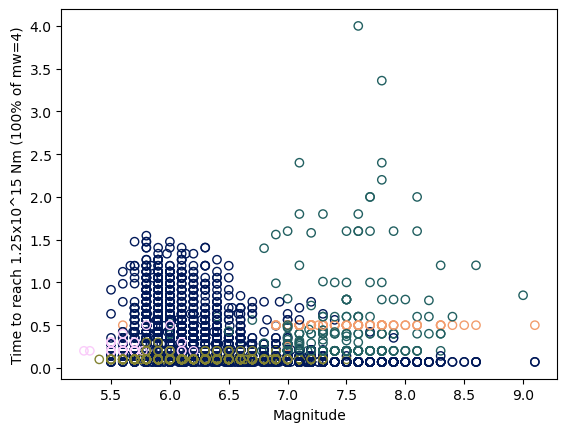

In [ ]:
plt.scatter(db['magnitude'], db['reaches_target'], edgecolors=[dataset_colors[d] for d in db['dataset']], facecolors='none')
plt.ylabel('Time to reach 1.25x10^15 Nm (100% of mw=4)')
plt.xlabel('Magnitude')
plt.savefig('/home/earthquakes1/homes/Rebecca/phd/stf/figures/time_for_absolute_moment/time_to_reach_target_100_percent_of_m4.png')

Spearman correlation: -0.32765114442902776, p-value: 8.004155296850554e-280


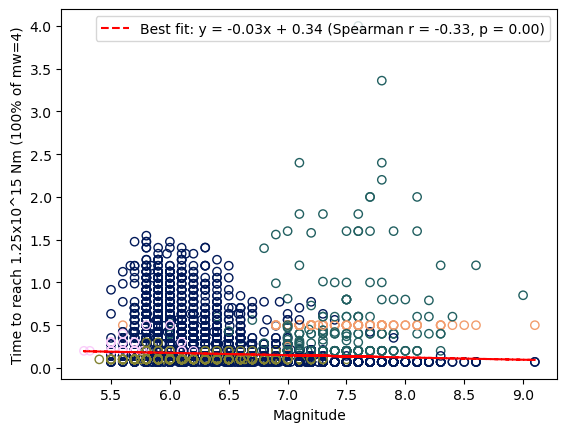

In [ ]:
plt.scatter(db_m4['magnitude'], db_m4['reaches_target'], edgecolors=[dataset_colors[d] for d in db_m4['dataset']], facecolors='none')
plt.ylabel('Time to reach 1.25x10^15 Nm (100% of mw=4)')
plt.xlabel('Magnitude')
# Fit a line of best fit
# Remove rows with NaN values in 'magnitude' or 'reaches_target' before fitting
clean_db = db_m4.dropna(subset=['magnitude', 'reaches_target'])
m, b = np.polyfit(clean_db['magnitude'], clean_db['reaches_target'], 1)
# Calculate Spearman correlation coefficient
spearman_r, spearman_p = stats.spearmanr(clean_db['magnitude'], clean_db['reaches_target'])
print(f'Spearman correlation: {spearman_r}, p-value: {spearman_p}')
plt.plot(db_m4['magnitude'], m*db_m4['magnitude'] + b, color='red', linestyle='--', label=f'Best fit: y = {m:.2f}x + {b:.2f} (Spearman r = {spearman_r:.2f}, p = {spearman_p:.2f})')
plt.legend()
plt.savefig('/home/earthquakes1/homes/Rebecca/phd/stf/figures/time_for_absolute_moment/time_to_reach_target_100_percent_of_m4.png')

/tmp/ipykernel_562316/2496333767.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  clean_db['reaches_target'] = pd.to_numeric(clean_db['reaches_target'], errors='coerce')


Spearman correlation: -0.22883689226589868, p-value: 2.193553950404603e-133


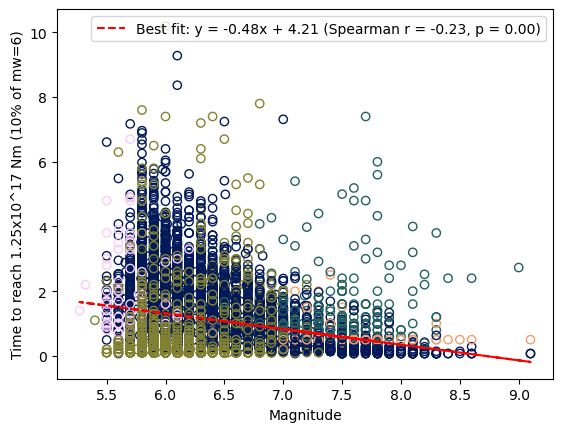

In [92]:
plt.scatter(db_m6['magnitude'], db_m6['reaches_target'], edgecolors=[dataset_colors[d] for d in db_m6['dataset']], facecolors='none')
plt.ylabel('Time to reach 1.25x10^17 Nm (10% of mw=6)')
plt.xlabel('Magnitude')
clean_db = db_m6.dropna(subset=['magnitude', 'reaches_target'])
clean_db['reaches_target'] = pd.to_numeric(clean_db['reaches_target'], errors='coerce')
m, b = np.polyfit(clean_db['magnitude'], clean_db['reaches_target'], 1)
spearman_r, spearman_p = stats.spearmanr(clean_db['magnitude'], clean_db['reaches_target'])
print(f'Spearman correlation: {spearman_r}, p-value: {spearman_p}')
plt.plot(db_m6['magnitude'], m*db_m6['magnitude'] + b, color='red', linestyle='--', label=f'Best fit: y = {m:.2f}x + {b:.2f} (Spearman r = {spearman_r:.2f}, p = {spearman_p:.2f})')
plt.legend()
plt.savefig('/home/earthquakes1/homes/Rebecca/phd/stf/figures/time_for_absolute_moment/time_to_reach_target_10_percent_of_m6.png')


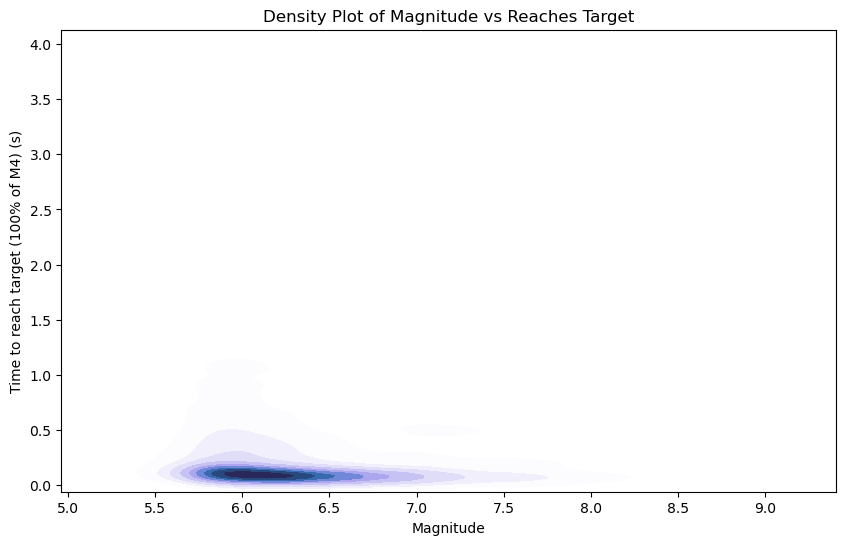

In [71]:
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.kdeplot(x=db['magnitude'], y=pd.to_numeric(db['reaches_target'], errors='coerce'), cmap=cmc.devon_r, fill=True)
plt.xlabel('Magnitude')
plt.ylabel('Time to reach target (100% of M4) (s)')
plt.title('Density Plot of Magnitude vs Reaches Target')
plt.savefig('/home/earthquakes1/homes/Rebecca/phd/stf/figures/time_for_absolute_moment/density_plot_magnitude_vs_reaches_target_100_percent_m4.png')
plt.show()

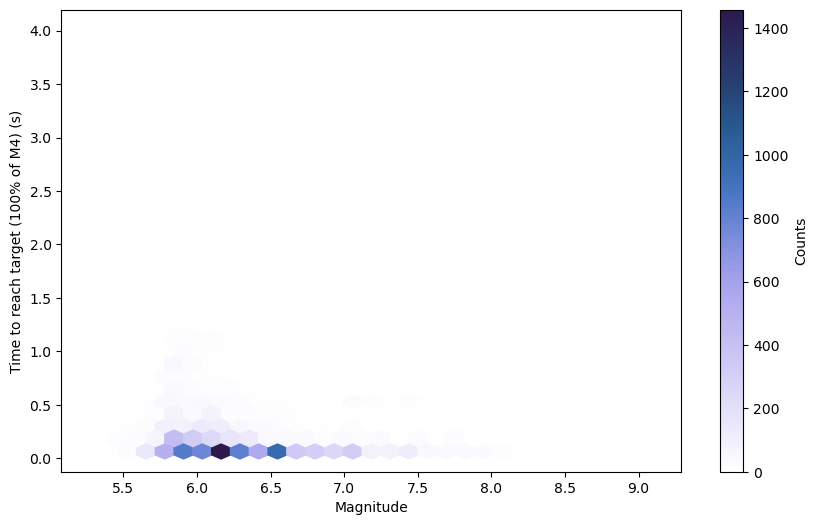

In [72]:
plt.figure(figsize=(10, 6))
plt.hexbin(db['magnitude'], pd.to_numeric(db['reaches_target'], errors='coerce'), gridsize=30, cmap=cmc.devon_r)
plt.colorbar(label='Counts')
plt.xlabel('Magnitude')
plt.ylabel('Time to reach target (100% of M4) (s)')
plt.savefig('/home/earthquakes1/homes/Rebecca/phd/stf/figures/time_for_absolute_moment/hexbin_magnitude_reaches_target_100_percent_m4.png')
plt.show()

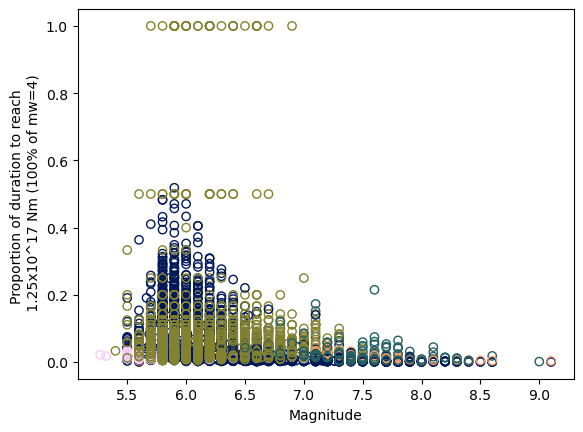

In [73]:
plt.scatter(db['magnitude'], db['reaches_target']/db['duration'], edgecolors=[dataset_colors[d] for d in db['dataset']], facecolors='none')
plt.ylabel('Proportion of duration to reach \n 1.25x10^17 Nm (100% of mw=4)')
plt.xlabel('Magnitude')
plt.savefig('/home/earthquakes1/homes/Rebecca/phd/stf/figures/time_for_absolute_moment/proportion_duration_to_reach_target_100_percent_of_m4.png')

In [ ]:
subset = db[db['depth'] < 70]

In [ ]:
subset = subset[subset['dataset'] == dataset]
subset = subset[subset['simpson'] > 10**16]
subset = subset[subset['simpson_short'] > 0]

In [ ]:
subset

,name,magnitude,depth,simpson,simpson_short,dataset
21,20120320_180247.txt,7.5,19.400,1.194007e+20,2.406388e+18,usgs
111,20200623_152904.txt,7.4,20.000,1.019129e+20,4.181914e+18,usgs
133,20161225_142227.txt,7.6,38.000,2.336611e+20,2.945970e+18,usgs
156,20190615_225504.txt,7.3,46.000,1.069137e+20,3.062174e+18,usgs
190,20110820_165502.txt,7.1,34.600,5.528505e+19,1.866083e+18,usgs
...,...,...,...,...,...,...
11760,20230206_102448.txt,7.5,10.000,4.412318e+20,4.043929e+18,usgs
11761,20231202_143704.txt,7.6,50.675,2.924153e+20,1.318501e+18,usgs
11762,19971108_100252.txt,7.4,38.100,2.005195e+20,3.038227e+18,usgs
11763,20181220_170155.txt,7.3,16.560,1.169586e+20,1.932563e+18,usgs


In [ ]:
np.log10(subset['simpson_short'])

21       18.381366
111      18.621375
133      18.469228
156      18.486030
190      18.270931
           ...    
11760    18.606804
11761    18.120080
11762    18.482620
11763    18.286134
11764    17.928186
Name: simpson_short, Length: 205, dtype: float64

Spearman correlation: 0.528764498165642, p-value: 0.0
5980 5980
Spearman correlation: -0.06074299006839297, p-value: 0.38693534570154187
205 205
Spearman correlation: 0.9369939651219074, p-value: 0.0
2136 2136
Spearman correlation: 0.36063682394135577, p-value: 0.00014611589381256202
106 106
Spearman correlation: 0.8827258497316638, p-value: 1.7608981306786992e-43
129 129
Spearman correlation: 0.5861426202564355, p-value: 0.0


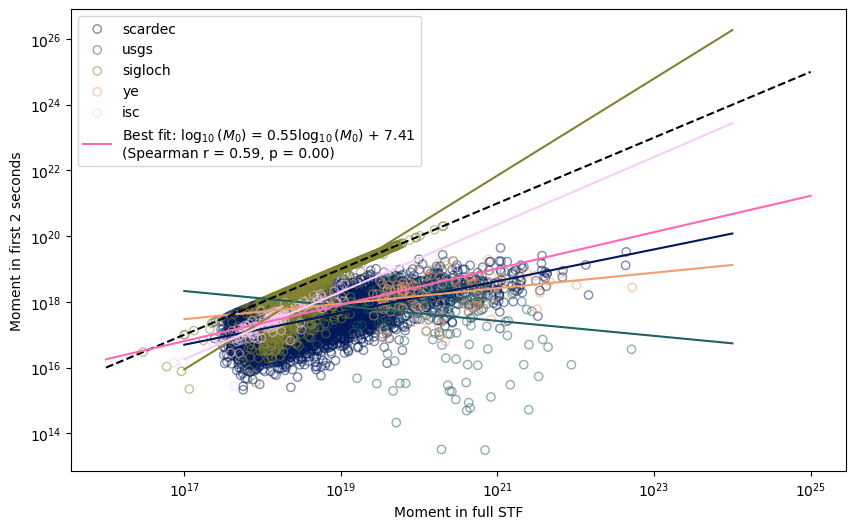

In [ ]:
colors = cmc.batlow(np.linspace(0, 1, 5))
unique_datasets = ['scardec', 'usgs', 'sigloch', 'ye', 'isc']
dataset_colors = {dataset: colors[i] for i, dataset in enumerate(unique_datasets)}

shallow = db[db['depth'] < 70]

plt.figure(figsize=(10, 6))
for dataset in unique_datasets:
	subset = shallow[shallow['dataset'] == dataset]
	subset = subset[subset['simpson'] > 10**16]
	subset = subset[subset['simpson_short'] > 0]
	if dataset != 'usgs':
		subset_no_nan = subset.dropna()
		subset = subset_no_nan[abs(subset_no_nan['magnitude']-2/3*(np.log10(subset_no_nan['simpson'])-9.1)) < 1]
	plt.scatter(subset['simpson'], subset['simpson_short'], label=dataset, alpha=0.5, facecolors='none', edgecolors=dataset_colors[dataset])

	spearman_r, spearman_p = stats.spearmanr(subset['simpson'], subset['simpson_short'])
	print(f'Spearman correlation: {spearman_r}, p-value: {spearman_p}')
	print(len(subset['simpson']), len(subset['simpson_short']))
	m, b = np.polyfit(np.log10(subset['simpson']), np.log10(subset['simpson_short']), 1)
	#m, b = np.polyfit(simpson, simpson_short, 1)

	plt.plot(np.array([10e16, 10e19, 10e23]),
			10**(m * np.log10(np.array([10e16, 10e19, 10e23])) + b),
			c=dataset_colors[dataset],
			linestyle = '-')


plt.xlabel('Moment in full STF')
plt.ylabel('Moment in first 2 seconds')

plt.plot([10**16, 10**25], [10**16, 10**25], ls='--', c='k')


subset = shallow[shallow['simpson'] > 10**16]
subset = subset[subset['simpson_short'] > 0]

spearman_r, spearman_p = stats.spearmanr(subset['simpson'], subset['simpson_short'])
print(f'Spearman correlation: {spearman_r}, p-value: {spearman_p}')

m, b = np.polyfit(np.log10(subset['simpson']), np.log10(subset['simpson_short']), 1)
#m, b = np.polyfit(simpson, simpson_short, 1)

plt.plot(np.array([10e15, 10e19, 10e24]),
		10**(m * np.log10(np.array([10e15, 10e19, 10e24])) + b),
		c='hotpink',
		label = fr'Best fit: $\log_{{10}}(M_0)$ = {m:.2f}$\log_{{10}}(M_0)$ + {b:.2f}' + '\n' + f'(Spearman r = {spearman_r:.2f}, p = {spearman_p:.2f})',
		linestyle = '-')


plt.yscale('log')
plt.xscale('log')

#plt.xlim(5,10)

plt.legend()
#plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/moment_in_absolute_time/moment_in_{time}_seconds.png')
plt.show()

In [ ]:
datasets_for_colors_2 = []
for d in datasets:
	if d.split('_')[0] == 'sigloch':
		datasets_for_colors_2.append(d.split('_')[0])
	else:
		datasets_for_colors_2.append(d)

In [ ]:
db_2 = pd.DataFrame({'name': names, 'magnitude': magnitudes, 'simpson': simpson, 'simpson_short': simpson_short, 'dataset': datasets_for_colors_2})

Spearman correlation: 0.5954395736041069, p-value: 0.0
Spearman correlation: 0.5327784833470017, p-value: 3.1751638402420104e-298
Spearman correlation: -0.012307772916612086, p-value: 0.847692108561401
Spearman correlation: 0.9511737463012797, p-value: 0.0
Spearman correlation: 0.3690482809748865, p-value: 7.851398511404162e-05
Spearman correlation: 0.8855072573272182, p-value: 4.0036180081739187e-50


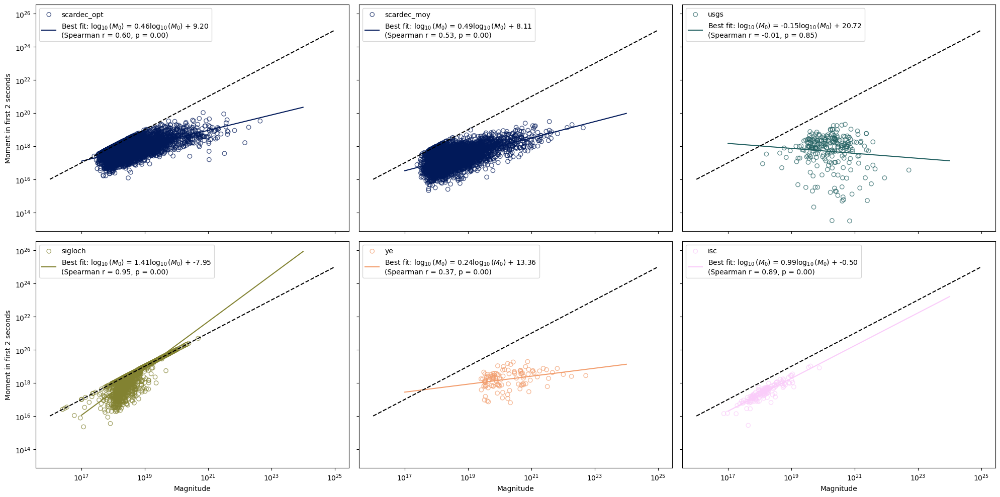

In [ ]:
colors = cmc.batlow(np.linspace(0, 1, 5))
unique_datasets = ['scardec', 'usgs', 'sigloch', 'ye', 'isc']
dataset_colors = {dataset: colors[i] for i, dataset in enumerate(unique_datasets)}

unique_datasets_2 = ['scardec_opt', 'scardec_moy', 'usgs', 'sigloch', 'ye', 'isc']

fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(20, 10), sharey=True, sharex=True)

for i, dataset in enumerate(unique_datasets_2):
	ax = axes[i//3, i%3]
	subset = db_2[db_2['dataset'] == dataset]
	subset = subset[subset['simpson'] > 10**16]
	subset = subset[subset['simpson_short'] > 0]
	if dataset != 'usgs':
		subset_no_nan = subset.dropna()
		subset = subset_no_nan[abs(subset_no_nan['magnitude']-2/3*(np.log10(subset_no_nan['simpson'])-9.1)) < 1]
	ax.scatter(subset['simpson'], subset['simpson_short'], label=dataset, alpha=0.7, facecolors='none', edgecolors=dataset_colors[dataset.split('_')[0]])
	#ax.set_xlim(5, 10)
	ax.set_yscale('log')
	ax.set_xscale('log')


	spearman_r, spearman_p = stats.spearmanr(subset['simpson'], subset['simpson_short'])
	print(f'Spearman correlation: {spearman_r}, p-value: {spearman_p}')

	m, b = np.polyfit(np.log10(subset['simpson']), np.log10(subset['simpson_short']), 1)
	#m, b = np.polyfit(simpson, simpson_short, 1)

	ax.plot(np.array([10e16, 10e19, 10e23]),
			10**(m * np.log10(np.array([10e16, 10e19, 10e23])) + b),
			c=dataset_colors[dataset.split('_')[0]],
			label = fr'Best fit: $\log_{{10}}(M_0)$ = {m:.2f}$\log_{{10}}(M_0)$ + {b:.2f}' + '\n' + f'(Spearman r = {spearman_r:.2f}, p = {spearman_p:.2f})',
			linestyle = '-')



	ax.plot([10**16, 10**25], [10**16, 10**25], ls='--', c='k')

	ax.legend()

	if i%3 == 0:
		ax.set_ylabel(f'Moment in first {time} seconds')
	if i//3 == 1:
		ax.set_xlabel('Magnitude')

plt.tight_layout()
plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/moment_in_absolute_time/moment_in_{time}_seconds_dataset.png')

plt.show()

In [ ]:
subset = db[db['dataset'] == 'sigloch']

(array([3.000e+00, 0.000e+00, 0.000e+00, 3.000e+00, 1.000e+00, 1.000e+00,
        2.548e+03, 1.486e+03, 2.010e+02, 1.900e+01]),
 array([0.    , 0.8794, 1.7588, 2.6382, 3.5176, 4.397 , 5.2764, 6.1558,
        7.0352, 7.9146, 8.794 ]),
 <BarContainer object of 10 artists>)

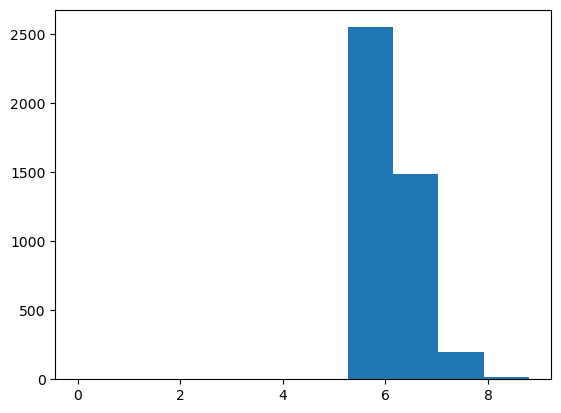

In [ ]:
plt.hist(subset.magnitude)

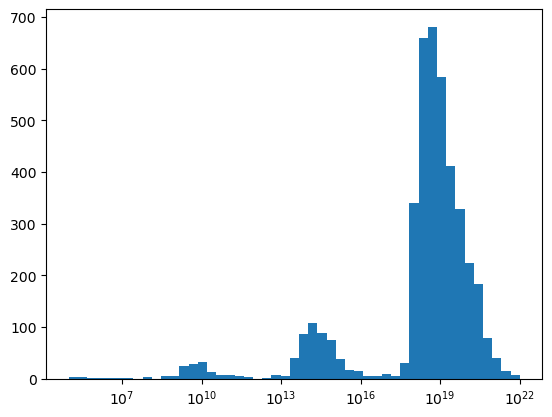

In [ ]:
plt.hist(subset['simpson'], bins = np.logspace(5, 22, 50))
plt.xscale('log')

In [22]:
def myround(x, base=1):
    return base * round(x/base)

In [20]:
catalog = pd.read_csv('/home/earthquakes1/homes/Rebecca/phd/stf/data/combined_m55_catalog.csv', sep = '|')
cols = catalog.columns
column_names = []
for c in cols:
    column_names.append(c.strip().rstrip().lower())
column_names[0] = 'catalog_id'
catalog.columns = column_names
catalog['year'] = catalog.apply(lambda x: x['time'][:4], axis = 1)
catalog['month'] = catalog.apply(lambda x: x['time'][5:7], axis = 1)
catalog['day'] = catalog.apply(lambda x: x['time'][8:10], axis = 1)
catalog['hour'] = catalog.apply(lambda x: x['time'][11:13], axis = 1)
catalog['minute'] = catalog.apply(lambda x: x['time'][14:16], axis = 1)

catalog['event'] = catalog.apply(lambda x: x['year'] + x['month'] + x['day'] + '_' + x['hour'] + x['minute'], axis = 1)

catalog['int_magnitude'] = catalog.apply(lambda x: myround(x['magnitude']), axis = 1)
catalog.drop(columns = ['contributor', 'contributorid', 'magauthor', 'eventlocationname', 'author', 'catalog', 'time'], inplace = True)
catalog = catalog[['event', 'catalog_id', 'year', 'month', 'day', 'hour', 'minute', 'latitude', 'longitude', 'depth/km', 'magnitude', 'int_magnitude', 'magtype']]

In [21]:
catalog

,event,catalog_id,year,month,day,hour,minute,latitude,longitude,depth/km,magnitude,int_magnitude,magtype
0,20250121_1115,11926233,2025,01,21,11,15,-3.7368,151.5823,10.000,5.5,6,Mww
1,20250121_0605,11926190,2025,01,21,06,05,-27.4829,-13.4632,10.000,5.5,6,mb
2,20250121_0547,11926184,2025,01,21,05,47,13.4344,144.3969,137.242,5.5,6,mww
3,20250120_1617,11926033,2025,01,20,16,17,23.2338,120.4749,10.000,6.0,6,mww
4,20250120_0838,11925968,2025,01,20,08,38,-11.3327,165.8206,35.000,5.6,6,mww
...,...,...,...,...,...,...,...,...,...,...,...,...,...
16101,19900108_1944,2808110,1990,01,08,19,44,52.0105,-169.6001,15.000,5.6,6,mb
16102,19900107_0906,2808066,1990,01,07,09,06,-15.9527,-74.2840,48.900,5.9,6,mb
16103,19900106_2144,2808053,1990,01,06,21,44,-10.6437,92.9744,15.000,5.9,6,mw
16104,19900104_0532,2807962,1990,01,04,05,32,-15.4219,-172.9087,42.600,6.4,6,mb


In [ ]:
row.event

'20240628_0536'

In [ ]:
event_cat = catalog[catalog['event']==row.event]

In [ ]:
event_cat['depth/km'].values[0]

24.442

In [31]:
db_m6

,name,magnitude,depth,simpson,reaches_target,duration,dataset
0,FCTs_20170818_025925_NORTH_OF_ASCENSION_ISLAND,6.6,10.000,9.240153e+18,0.984375,19.617188,scardec
1,FCTs_20170818_025925_NORTH_OF_ASCENSION_ISLAND,6.6,10.000,9.906913e+18,1.265625,21.164062,scardec
2,FCTs_20110126_154229_NORTHERN_SUMATRA__INDONESIA,6.0,23.800,2.067641e+18,2.8125,11.320312,scardec
3,FCTs_20110126_154229_NORTHERN_SUMATRA__INDONESIA,6.0,23.800,1.956907e+18,4.148438,12.445312,scardec
4,0706.2011.026.a,6.0,23.800,1.741252e+18,1.5,6.000000,sigloch
...,...,...,...,...,...,...,...
11253,20230206_102448.txt,7.5,10.000,4.412318e+20,0.64,34.020000,usgs
11254,20231202_143704.txt,7.6,50.675,2.924153e+20,0.99,29.550000,usgs
11255,19971108_100252.txt,7.4,38.100,2.005195e+20,0.8,39.000000,usgs
11256,20181220_170155.txt,7.3,16.560,1.169586e+20,0.8,35.600000,usgs


/tmp/ipykernel_1931993/1282985266.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  clean_db['reaches_target'] = pd.to_numeric(clean_db['reaches_target'], errors='coerce')


Spearman correlation: -0.4855507958395641, p-value: 0.0
Spearman correlation: 0.15052854052566322, p-value: 1.6659573956328827e-14
Spearman correlation: -0.14707448177575974, p-value: 0.12698200408809096
Spearman correlation: 0.04225624143981229, p-value: 0.5138372786956964
Spearman correlation: -0.5732679837282616, p-value: 4.861021179671275e-14


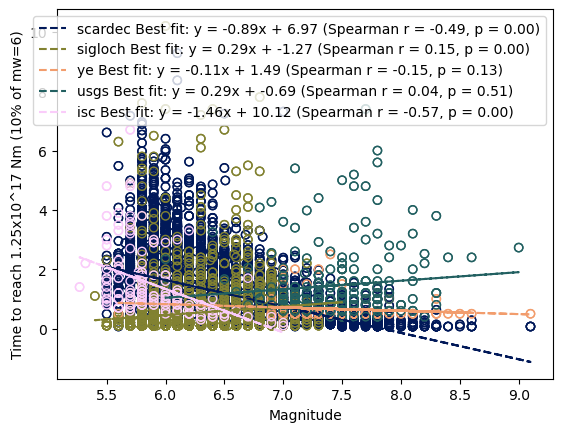

In [32]:
plt.scatter(db_m6['magnitude'], db_m6['reaches_target'], edgecolors=[dataset_colors[d] for d in db_m6['dataset']], facecolors='none')
plt.ylabel('Time to reach 1.25x10^17 Nm (10% of mw=6)')
plt.xlabel('Magnitude')
clean_db = db_m6.dropna(subset=['magnitude', 'reaches_target'])
clean_db['reaches_target'] = pd.to_numeric(clean_db['reaches_target'], errors='coerce')
for dataset in clean_db['dataset'].unique():
	subset = clean_db[clean_db['dataset'] == dataset]
	subset = subset[subset['reaches_target'] > 0]
	plt.scatter(subset['magnitude'], subset['reaches_target'], edgecolors=dataset_colors[dataset], facecolors='none')
	m, b = np.polyfit(subset['magnitude'], subset['reaches_target'], 1)
	spearman_r, spearman_p = stats.spearmanr(subset['magnitude'], subset['reaches_target'])
	print(f'Spearman correlation: {spearman_r}, p-value: {spearman_p}')
	plt.plot(subset['magnitude'], m*subset['magnitude'] + b, color=dataset_colors[dataset], linestyle='--', label=f'{dataset} Best fit: y = {m:.2f}x + {b:.2f} (Spearman r = {spearman_r:.2f}, p = {spearman_p:.2f})')
plt.legend()
plt.show()
#plt.savefig('/home/earthquakes1/homes/Rebecca/phd/stf/figures/time_for_absolute_moment/time_to_reach_target_10_percent_of_m6.png')
